In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier, plot_tree, export_graphviz
from sklearn.metrics import accuracy_score
import graphviz
from IPython.display import Image
import os

In [ ]:
feature_matrix_train = np.load("/content/drive/MyDrive/mlinmb/2/feature_matrix_train.npy")
label_array_train = np.load("/content/drive/MyDrive/mlinmb/2/label_array_train.npy")

feature_matrix_valid = np.load("/content/drive/MyDrive/mlinmb/2/feature_matrix_valid.npy")
label_array_valid = np.load("/content/drive/MyDrive/mlinmb/2/label_array_valid.npy")

feature_matrix_test = np.load("/content/drive/MyDrive/mlinmb/2/feature_matrix_test.npy")
label_array_test = np.load("/content/drive/MyDrive/mlinmb/2/label_array_test.npy")


1. Use a decision tree classifier to train a model
on the training data.

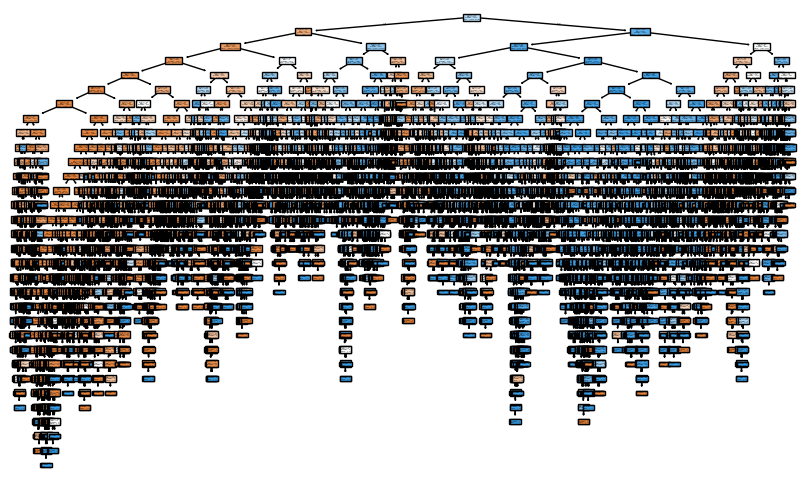

In [ ]:
clf = DecisionTreeClassifier()
clf.fit(feature_matrix_train, label_array_train)

plt.figure(figsize=(10, 6))
plot_tree(clf, filled=True)
plt.show()


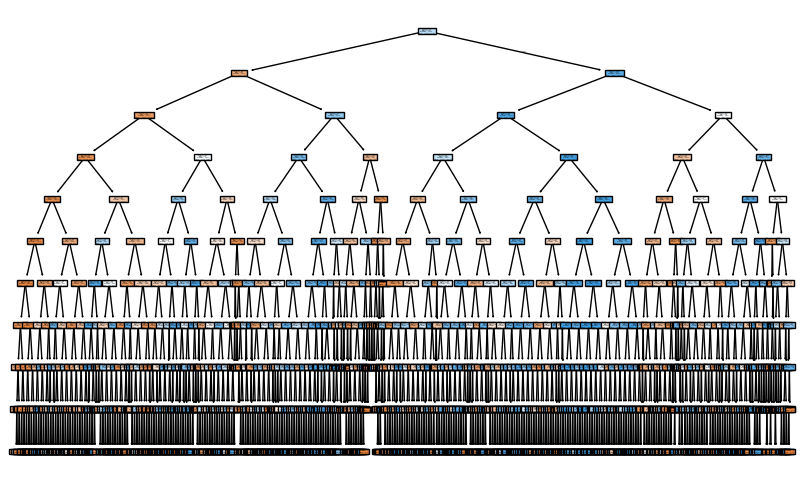

In [ ]:
clf = DecisionTreeClassifier(max_depth=10)
clf.fit(feature_matrix_train, label_array_train)

plt.figure(figsize=(10, 6))
plot_tree(clf, filled=True)
plt.show()


In [ ]:
feature_matrix_train_sample = feature_matrix_train[:2000]
label_array_train_sample = label_array_train[:2000]


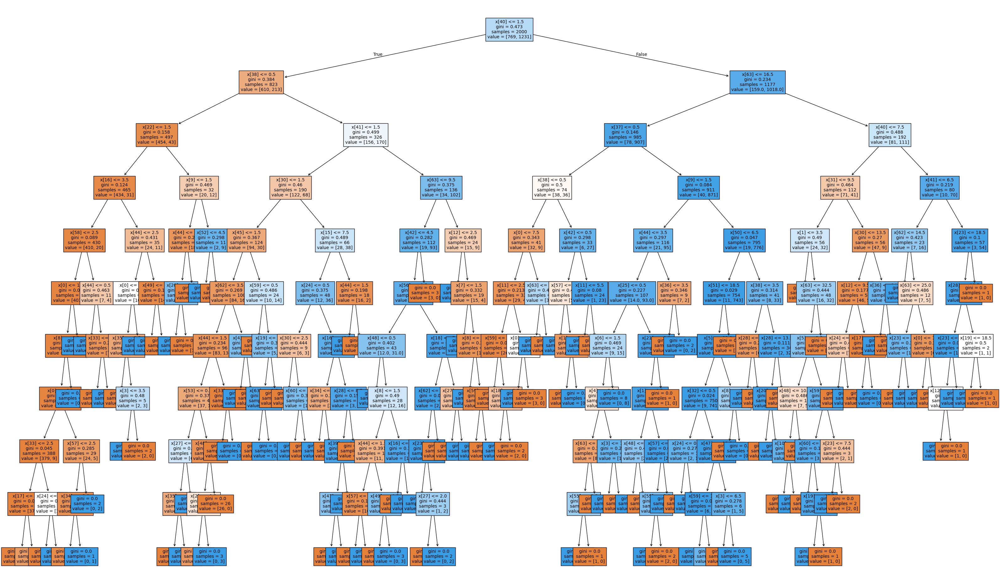

In [ ]:
clf = DecisionTreeClassifier(max_depth=10)
clf.fit(feature_matrix_train_sample, label_array_train_sample)

plt.figure(figsize=(40, 24))
plot_tree(
    clf,
    filled=True,
    fontsize=10
)
plt.show()


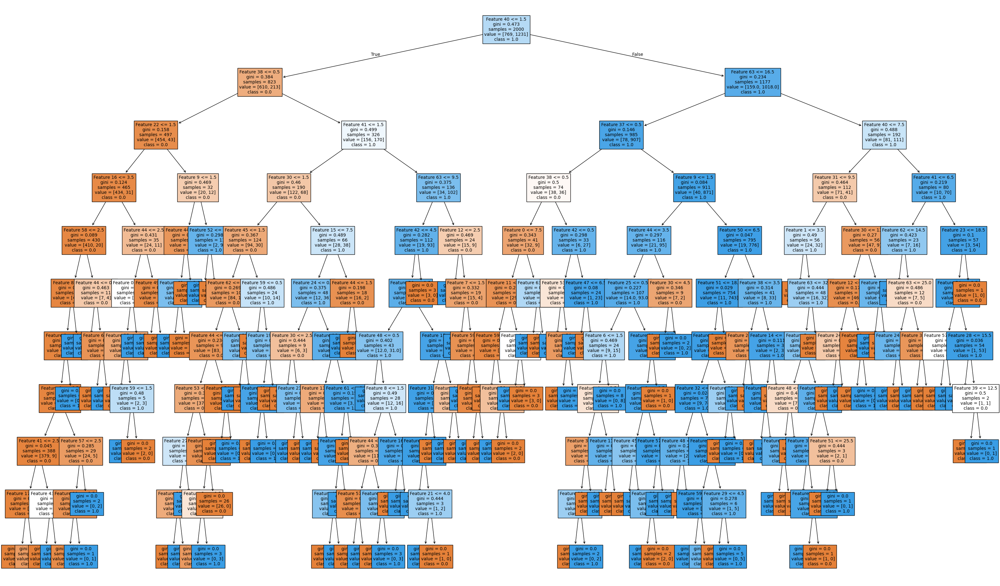

In [ ]:
clf = DecisionTreeClassifier(max_depth=10)
clf.fit(feature_matrix_train_sample, label_array_train_sample)

plt.figure(figsize=(40, 24))
plot_tree(
    clf,
    feature_names=[f"Feature {i}" for i in range(feature_matrix_train.shape[1])],
    class_names=[str(i) for i in set(label_array_train)],
    filled=True,
    fontsize=10
)
plt.show()



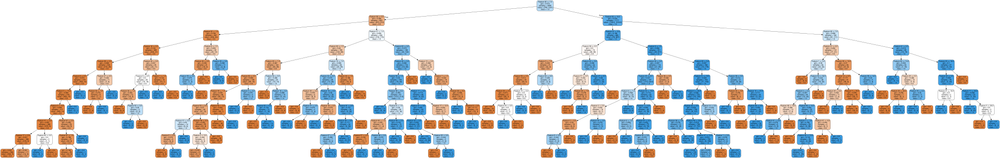

In [ ]:
clf = DecisionTreeClassifier(max_depth=10)
clf.fit(feature_matrix_train_sample, label_array_train_sample)

dot_data = export_graphviz(
    clf,
    out_file=None,
    feature_names=[f"Feature {i}" for i in range(feature_matrix_train.shape[1])],
    class_names=[str(i) for i in set(label_array_train)],
    filled=True,
    rounded=True
)
graph = graphviz.Source(dot_data)
graph

2. Experiment with:
a. max_depth: The maximum depth of the tree.
b. min_samples_split: The minimum number of samples required to split an
internal node.
c. criterion: The function to measure the quality of a split (gini or entropy).

3. Use the validation data to evaluate
different hyperparameter combinations.

4. Select the combination of hyperparameters that results in the highest accuracy on
the validation set (this accuracy score should be comparable to the one obtained
on the training set).

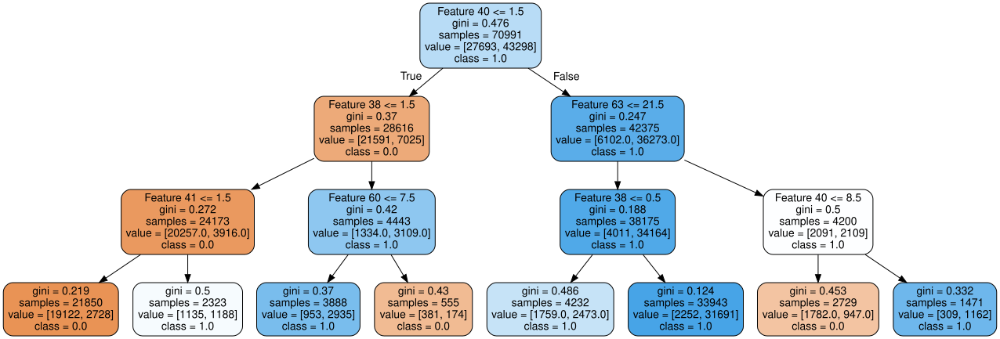

Evaluated combination: max_depth=3, min_samples_split=2, criterion=gini -> Accuracy: 0.8561


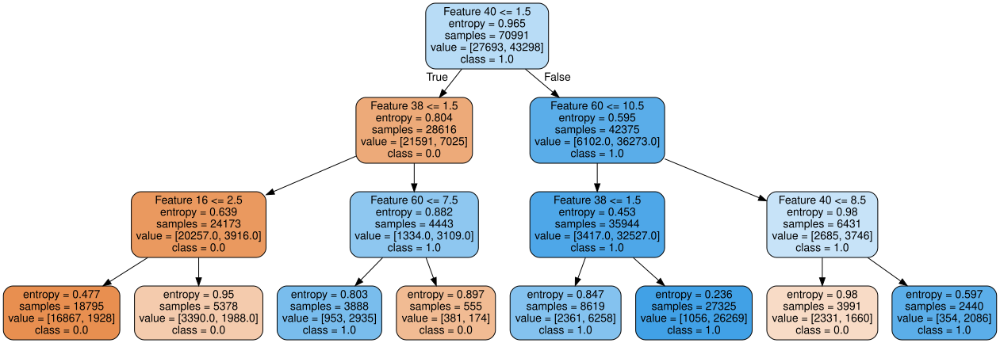

Evaluated combination: max_depth=3, min_samples_split=2, criterion=entropy -> Accuracy: 0.8503


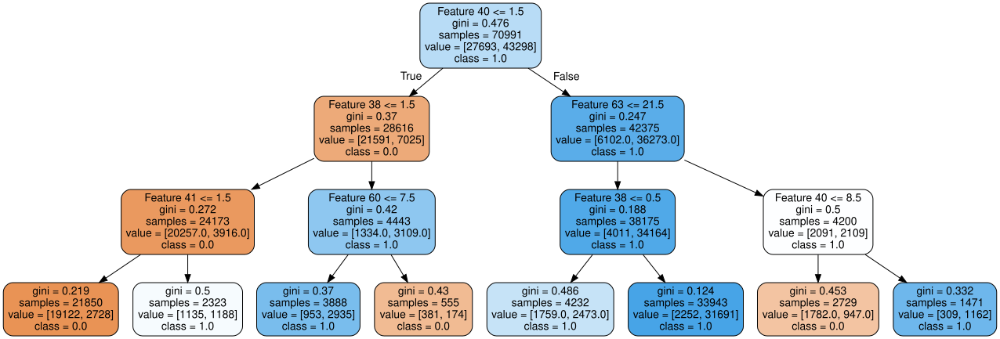

Evaluated combination: max_depth=3, min_samples_split=5, criterion=gini -> Accuracy: 0.8561


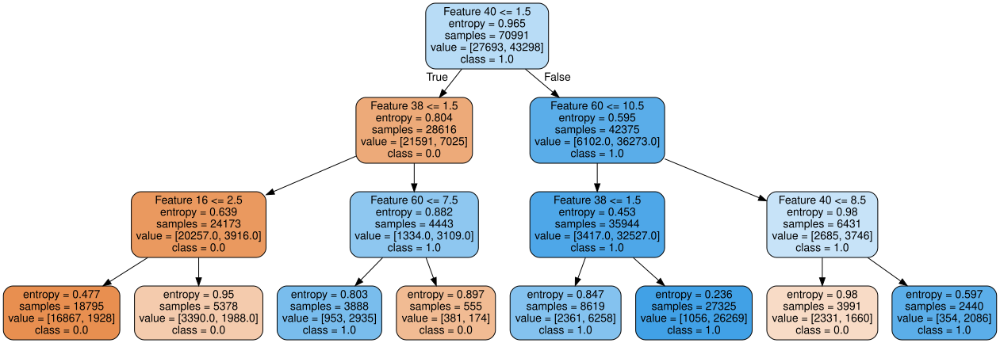

Evaluated combination: max_depth=3, min_samples_split=5, criterion=entropy -> Accuracy: 0.8503


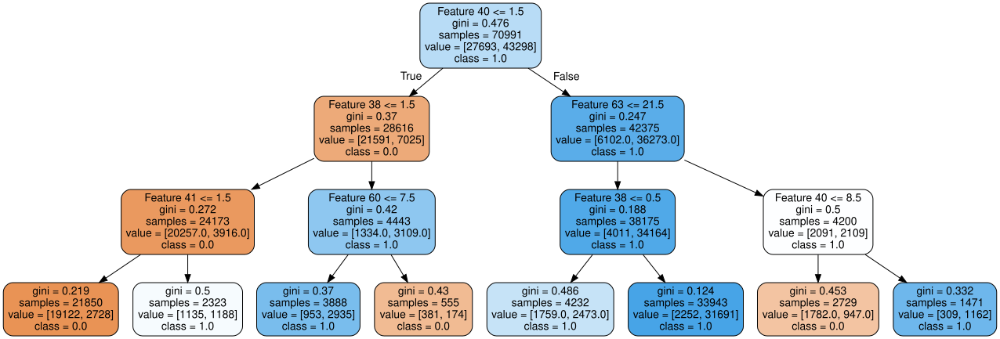

Evaluated combination: max_depth=3, min_samples_split=10, criterion=gini -> Accuracy: 0.8561


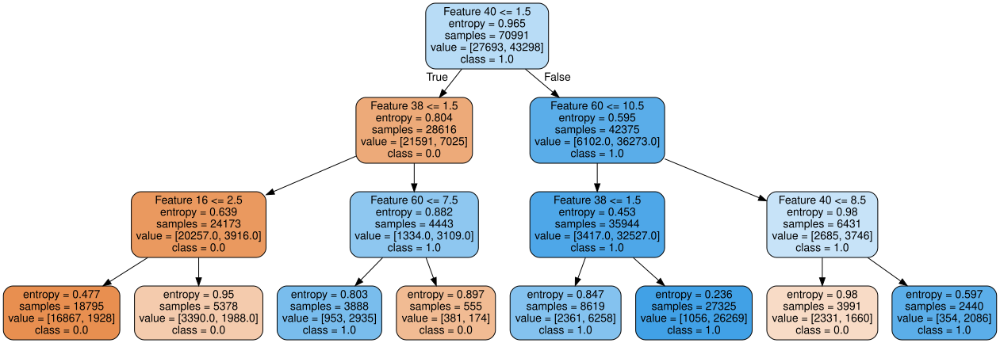

Evaluated combination: max_depth=3, min_samples_split=10, criterion=entropy -> Accuracy: 0.8503


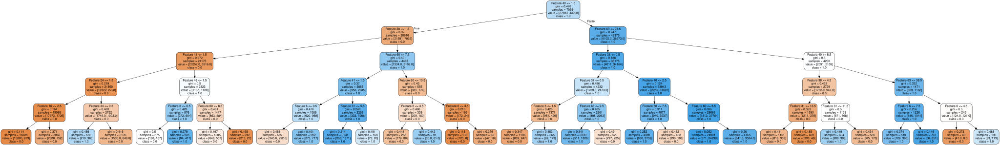

Evaluated combination: max_depth=5, min_samples_split=2, criterion=gini -> Accuracy: 0.8714


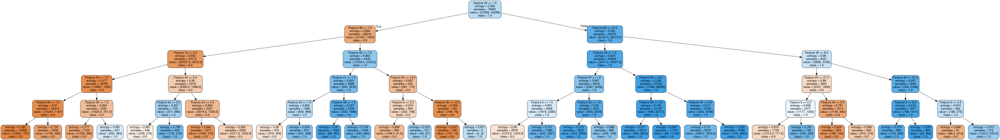

Evaluated combination: max_depth=5, min_samples_split=2, criterion=entropy -> Accuracy: 0.8644


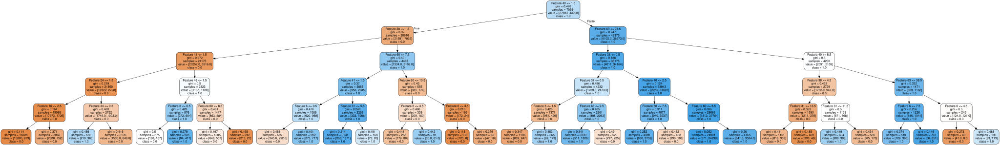

Evaluated combination: max_depth=5, min_samples_split=5, criterion=gini -> Accuracy: 0.8714


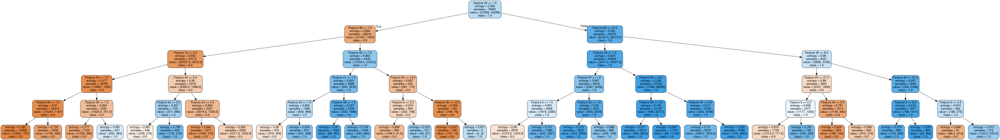

Evaluated combination: max_depth=5, min_samples_split=5, criterion=entropy -> Accuracy: 0.8644


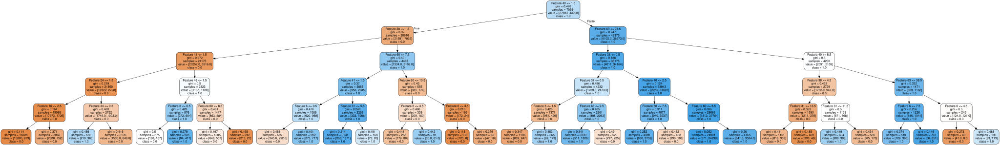

Evaluated combination: max_depth=5, min_samples_split=10, criterion=gini -> Accuracy: 0.8714


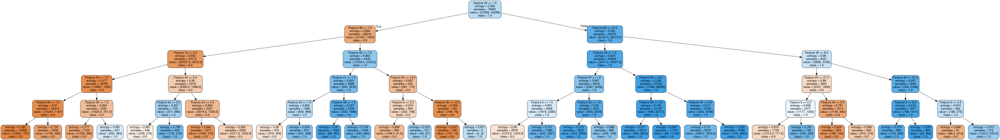

Evaluated combination: max_depth=5, min_samples_split=10, criterion=entropy -> Accuracy: 0.8644


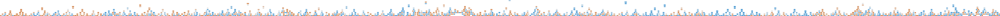

Evaluated combination: max_depth=10, min_samples_split=2, criterion=gini -> Accuracy: 0.8859


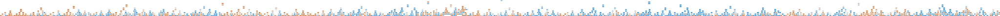

Evaluated combination: max_depth=10, min_samples_split=2, criterion=entropy -> Accuracy: 0.8860


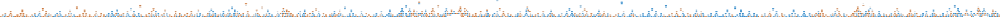

Evaluated combination: max_depth=10, min_samples_split=5, criterion=gini -> Accuracy: 0.8857


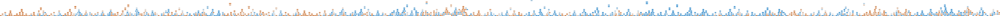

Evaluated combination: max_depth=10, min_samples_split=5, criterion=entropy -> Accuracy: 0.8856


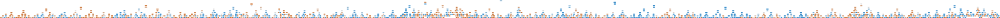

Evaluated combination: max_depth=10, min_samples_split=10, criterion=gini -> Accuracy: 0.8854


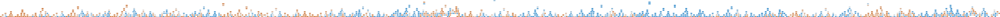

Evaluated combination: max_depth=10, min_samples_split=10, criterion=entropy -> Accuracy: 0.8854

Best Hyperparameters:
Max Depth: 10
Min Samples Split: 2
Criterion: entropy
Best Validation Accuracy: 0.8860


In [ ]:
max_depth_values = [3, 5, 10]
min_samples_split_values = [2, 5, 10]
criteria = ["gini", "entropy"]

best_accuracy = 0
best_hyperparameters = {}


for max_depth in max_depth_values:
    for min_samples_split in min_samples_split_values:
        for criterion in criteria:

            clf = DecisionTreeClassifier(
                max_depth=max_depth,
                min_samples_split=min_samples_split,
                criterion=criterion
            )
            clf.fit(feature_matrix_train, label_array_train)

            valid_predictions = clf.predict(feature_matrix_valid)
            accuracy = accuracy_score(label_array_valid, valid_predictions)

            if accuracy > best_accuracy:
                best_accuracy = accuracy
                best_hyperparameters = {
                    "max_depth": max_depth,
                    "min_samples_split": min_samples_split,
                    "criterion": criterion
                }

            dot_data = export_graphviz(
                clf,
                out_file=None,
                feature_names=[f"Feature {i}" for i in range(feature_matrix_train.shape[1])],
                class_names=[str(i) for i in set(label_array_train)],
                filled=True,
                rounded=True
            )
            graph = graphviz.Source(dot_data)
            display(graph)

            print(f"Evaluated combination: max_depth={max_depth}, min_samples_split={min_samples_split}, criterion={criterion} -> Accuracy: {accuracy:.4f}")

print("\nBest Hyperparameters:")
print(f"Max Depth: {best_hyperparameters['max_depth']}")
print(f"Min Samples Split: {best_hyperparameters['min_samples_split']}")
print(f"Criterion: {best_hyperparameters['criterion']}")
print(f"Best Validation Accuracy: {best_accuracy:.4f}")


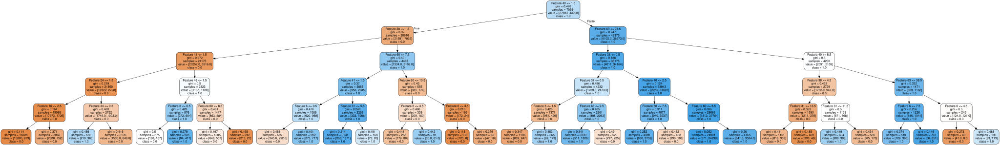

Evaluated combination: max_depth=5, min_samples_split=50, criterion=gini -> Accuracy: 0.8714


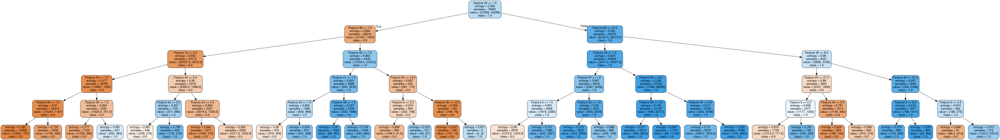

Evaluated combination: max_depth=5, min_samples_split=50, criterion=entropy -> Accuracy: 0.8644


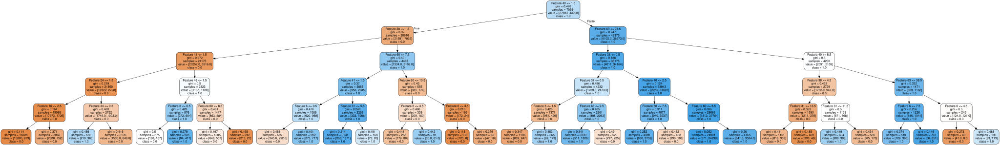

Evaluated combination: max_depth=5, min_samples_split=100, criterion=gini -> Accuracy: 0.8714


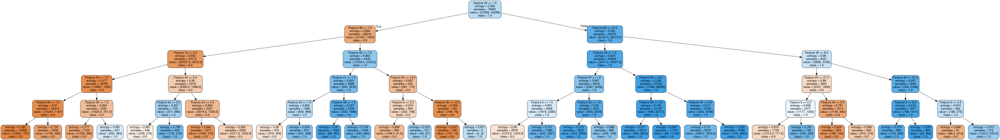

Evaluated combination: max_depth=5, min_samples_split=100, criterion=entropy -> Accuracy: 0.8644


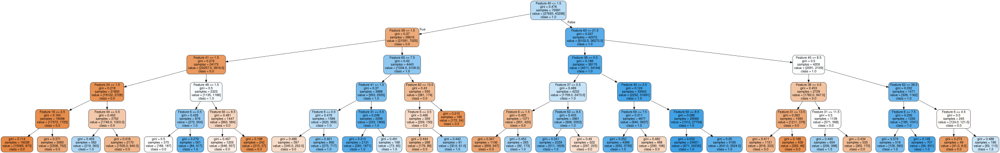

Evaluated combination: max_depth=5, min_samples_split=200, criterion=gini -> Accuracy: 0.8714


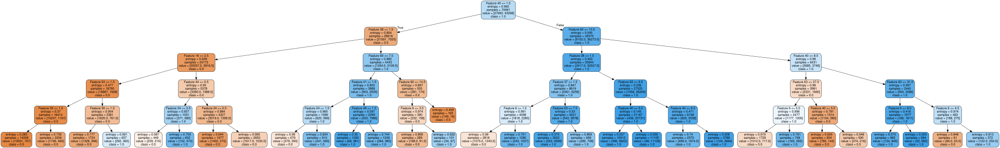

Evaluated combination: max_depth=5, min_samples_split=200, criterion=entropy -> Accuracy: 0.8646


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.610198 to fit


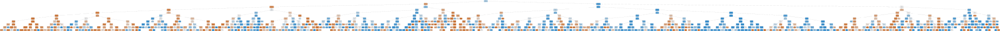

Evaluated combination: max_depth=10, min_samples_split=50, criterion=gini -> Accuracy: 0.8863


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.49109 to fit


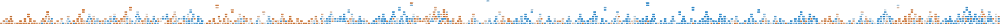

Evaluated combination: max_depth=10, min_samples_split=50, criterion=entropy -> Accuracy: 0.8863


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.89721 to fit


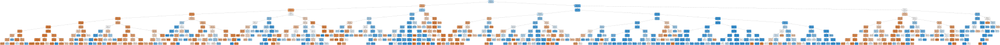

Evaluated combination: max_depth=10, min_samples_split=100, criterion=gini -> Accuracy: 0.8865


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.723222 to fit


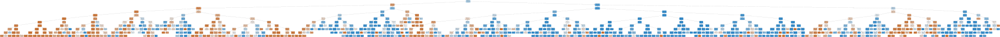

Evaluated combination: max_depth=10, min_samples_split=100, criterion=entropy -> Accuracy: 0.8867


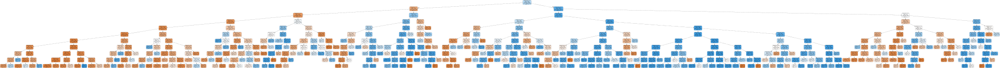

Evaluated combination: max_depth=10, min_samples_split=200, criterion=gini -> Accuracy: 0.8840


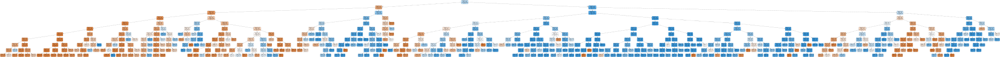

Evaluated combination: max_depth=10, min_samples_split=200, criterion=entropy -> Accuracy: 0.8868


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.460722 to fit


Evaluated combination: max_depth=15, min_samples_split=50, criterion=gini -> Accuracy: 0.8795


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.361304 to fit


Evaluated combination: max_depth=15, min_samples_split=50, criterion=entropy -> Accuracy: 0.8820


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.760661 to fit


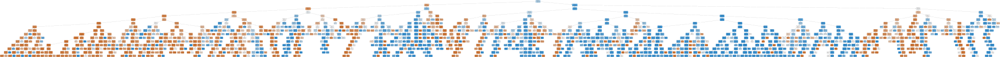

Evaluated combination: max_depth=15, min_samples_split=100, criterion=gini -> Accuracy: 0.8836


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.604513 to fit


Evaluated combination: max_depth=15, min_samples_split=100, criterion=entropy -> Accuracy: 0.8855


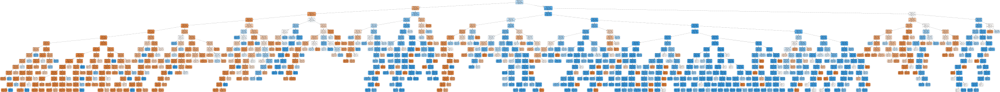

Evaluated combination: max_depth=15, min_samples_split=200, criterion=gini -> Accuracy: 0.8820


dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.975237 to fit


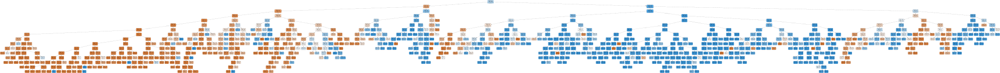

Evaluated combination: max_depth=15, min_samples_split=200, criterion=entropy -> Accuracy: 0.8856

Best Hyperparameters:
Max Depth: 10
Min Samples Split: 200
Criterion: entropy
Best Validation Accuracy: 0.8868


In [ ]:
max_depth_values = [5, 10, 15]
min_samples_split_values = [50, 100, 200]
criteria = ["gini", "entropy"]

output_folder = "tree_visualizations"
os.makedirs(output_folder, exist_ok=True)

best_accuracy = 0
best_hyperparameters = {}

for max_depth in max_depth_values:
    for min_samples_split in min_samples_split_values:
        for criterion in criteria:

            clf = DecisionTreeClassifier(
                max_depth=max_depth,
                min_samples_split=min_samples_split,
                criterion=criterion
            )
            clf.fit(feature_matrix_train, label_array_train)

            valid_predictions = clf.predict(feature_matrix_valid)
            accuracy = accuracy_score(label_array_valid, valid_predictions)

            if accuracy > best_accuracy:
                best_accuracy = accuracy
                best_hyperparameters = {
                    "max_depth": max_depth,
                    "min_samples_split": min_samples_split,
                    "criterion": criterion
                }

            dot_data = export_graphviz(
                clf,
                out_file=None,
                feature_names=[f"Feature {i}" for i in range(feature_matrix_train.shape[1])],
                class_names=[str(i) for i in set(label_array_train)],
                filled=True,
                rounded=True
            )

            graph = graphviz.Source(dot_data)
            filename = f"tree_maxdepth{max_depth}_split{min_samples_split}_criterion{criterion}"
            graph.render(filename=os.path.join(output_folder, filename), format="png", cleanup=True)
            display(graph)


            print(f"Evaluated combination: max_depth={max_depth}, min_samples_split={min_samples_split}, criterion={criterion} -> Accuracy: {accuracy:.4f}")

print("\nBest Hyperparameters:")
print(f"Max Depth: {best_hyperparameters['max_depth']}")
print(f"Min Samples Split: {best_hyperparameters['min_samples_split']}")
print(f"Criterion: {best_hyperparameters['criterion']}")
print(f"Best Validation Accuracy: {best_accuracy:.4f}")


Best Validation Accuracy: 0.8868

I mounted google drive and prepared neccesary dependecies. Next I loaded training, validation nad test data using np.load. Next I trained DecissionTreeClassifier from scikit without using any parameteres for constraining the model and I saw that the tree graph that I generated using matplotlib was unreadable, therefore I tried limiting tree depth to 10 but the graph was still gigantic. Knowning it is an excercise I decided to limit data that the model was using for predictions for better readability. Taking inspiration from notebook chapter 6 from the Hands-On Machine Learning with Scikit-Learn, Keras & TensorFlow. I used simple graphviz visualization options. This increased readability. At first i did not save graphs and only displayed them, but it was easier to view them in png.

Next I wrote a simple for loop to test how different parameters combinations affect tree stucture and accuracy calculated on validation set. Differences in accuracy were not huge, differing only in about 0.03. However, tree structures varied significantly depending on the parameter choices.

Best Hyperparameters:
Max Depth: 10
Min Samples Split: 2
Criterion: entropy
Best Validation Accuracy: 0.8860

I thought that parameters values I chose were too small for this dataset so I increased them. Accuracy didn't change a lot, max depth and crierion  didnt change at all, but it turns out that min samples split should be set higher. The smaller max depth and bigger min samples split values were the more compact the tree was. The biggest and most detailed tree was with max depth = 15 and min samples = 50.

Best Hyperparameters:
Max Depth: 10
Min Samples Split: 200
Criterion: entropy
Best Validation Accuracy: 0.8869



---



Knowledge:
1. Read the slides about decision trees.
2. Answer the following questions in the same Jupyter notebook that includes the classifier
described above, each in one cell:


a. Is a node’s Gini impurity generally lower or higher than its parent’s? Is it
generally lower/higher, or always lower/higher?

b. If a decision tree is overfitting the training set, is it a good idea to try decreasing
the maximum depth hyper parameter?

c. List at least five hyper parameters that can control the complexity of a decision
tree.

d. True or False: Decision trees are considered black boxes because we can explain
how they reached a decision.

e. Explain why the CART algorithm is a greedy and recursive algorithm.
Save your Jupyter notebook as an HTML image that includes all steps and the results.

a. Most often its lower than its parents, but sometimes it can be higher if decrease in the other childs impurity is big enough.

b. Yes. It is called reularization of model's freedom during training.

c. max_depth - how many layers a tree has from the root to the leaves
min_samples_split - minimum number of samples required to split a node
min_samples_leaf - minimum number of samples required to be in a leaf node
max_leaf_nodes - maximum number of leaf nodes in the tree
max_features - number of features considered when splitting

d. False. Decision trees are considered white boxes - we can know step by step how the tree made a decision.

e. Greedy - it makes the decision of spliiting locally without consideration how this will affect final tree structure . Recursive - it repeats the same process on differnet steps (nodes).